# Data Preparation
The dataset for training and validation was organized into appropriate directories, ensuring a clear separation between training, validation, and testing data.

**Note:** The KeyPoints of training dataset are converted to required format before training.


**Mounting Google Drive:** We started by mounting Google Drive to access the dataset.

In [16]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Installing Dependencies:** Installed the necessary packages, including Ultralytics for YOLO.

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.6/780.6 kB 9.1 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.2.32 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 30.2/78.2 GB disk)


**Creating Directories:** Created directories for storing training, validation, and testing datasets.

Sets up the directory structure for organizing the dataset.

In [ ]:
!mkdir datasets
!mkdir datasets/train
!mkdir datasets/valid
!mkdir datasets/test

train_path='datasets/train/'
valid_path='datasets/valid/'
test_path='datasets/test/'

In [17]:
ano_paths=[]
for dirname, _, filenames in os.walk('/content/drive/MyDrive/Training'):
    for filename in filenames:
        if filename[-4:]=='.txt':
            ano_paths+=[(os.path.join(dirname, filename))]

**Splitting Data:** Collects annotation files from the specified directory and splits them into training and validation sets.

In [18]:
n=len(ano_paths)
print(n)
N=list(range(n))
random.shuffle(N)

train_ratio = 0.8
valid_ratio = 0.2

train_size = int(train_ratio*n)
valid_size = int(valid_ratio*n)

train_i = N[:train_size]
valid_i = N[train_size:]

560


# Collecting Testing Annotations

Collects annotation files for the test set.

In [19]:
tano_paths=[]
for dirname, _, filenames in os.walk('/content/drive/MyDrive/Testing'):
    for filename in filenames:
        if filename[-4:]=='.txt' and filename!='classes.txt':
            tano_paths+=[(os.path.join(dirname, filename))]

# Copying Files:
Copied images and corresponding annotation files to the respective directories.


In [ ]:
for i in train_i:
    ano_path=ano_paths[i]
    img_path=os.path.join('/content/drive/MyDrive/Training',
                    ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {train_path}
        !cp {img_path} {train_path}
    except:
        continue
print(len(os.listdir(train_path)))

896


# Creating YAML Configuration
This creates a YAML file that defines the dataset structure and class names for the YOLO model.

In [ ]:
for i in valid_i:
    ano_path=ano_paths[i]
    img_path=os.path.join('/content/drive/MyDrive/Training',
                    ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {valid_path}
        !cp {img_path} {valid_path}
    except:
        continue
print(len(os.listdir(valid_path)))

224


In [20]:
for i in range(len(tano_paths)):
    ano_path=tano_paths[i]
    img_path=os.path.join('/content/drive/MyDrive/Testing',
                    ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {test_path}
        !cp {img_path} {test_path}
    except:
        continue
print(len(os.listdir(test_path)))

0


In [21]:
import yaml

data_yaml = dict(
    train ='train',
    val ='valid',
    test='test',
    nc =9,
    names =['Mouth','Eye','Top fin','Fish center','Bottom center','start point tail','top outline tail','mid outline tail','bottom outline tail']
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

%cat data.yaml

{names: [Mouth, Eye, Top fin, Fish center, Bottom center, start point tail, top outline
      tail, mid outline tail, bottom outline tail], nc: 9, test: test, train: train,
  val: valid}


In [ ]:
names =['Mouth','Eye','Top fin','Fish center','Bottom center','start point tail','top outline tail','mid outline tail','bottom outline tail']
M=list(range(len(names)))
class_map=dict(zip(M,names))

# Model Initialization
The YOLO model was trained using the prepared dataset.


**Model Initialization:** Loaded the pre-trained YOLO model.

In [22]:
model = YOLO("yolov8x.pt")

**Training:** Configured and initiated the training process.
<br><br>
**Training Configuration:**<br>
Model: YOLOv8<br>
Epochs: 75<br>
Image Size: 640<br>




Trains the YOLO model with the specified parameters.

In [23]:
!yolo task=detect mode=train model=yolov8x.pt data=data.yaml epochs=75 imgsz=640

Ultralytics YOLOv8.2.32 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=data.yaml, epochs=75, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line

4. Training Results
The training results included the model's weights and performance metrics.


# Displaying Training Results
Displays images from the training results to visualize the training performance.

In [24]:
paths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train2'):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)
print(len(paths2))
print(paths2[0:3])

14
['/content/runs/detect/train2/labels.jpg', '/content/runs/detect/train2/labels_correlogram.jpg', '/content/runs/detect/train2/train_batch0.jpg']


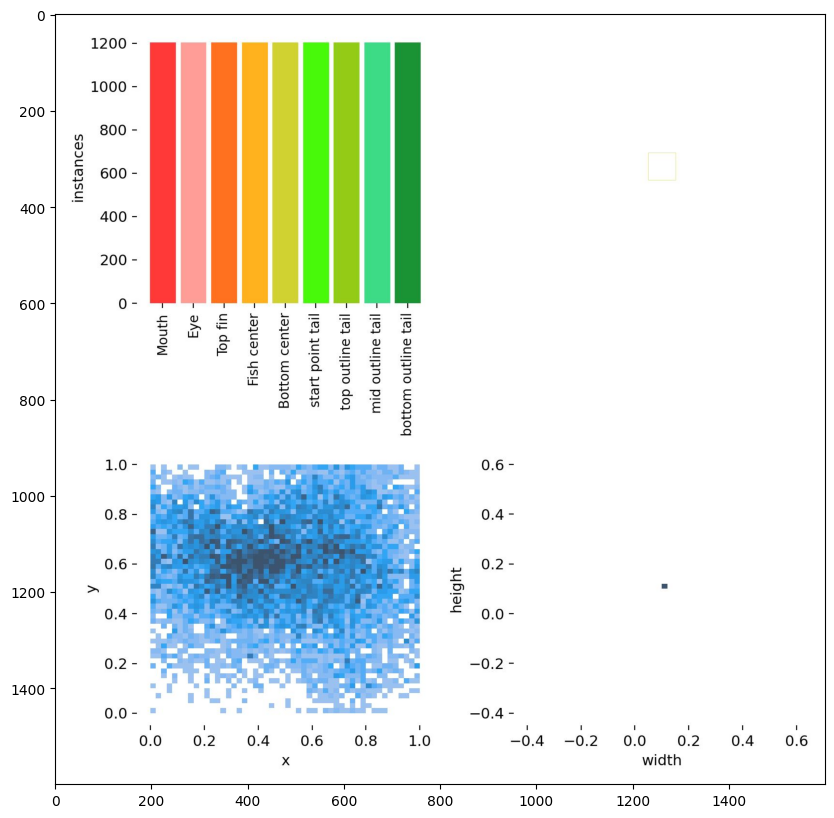

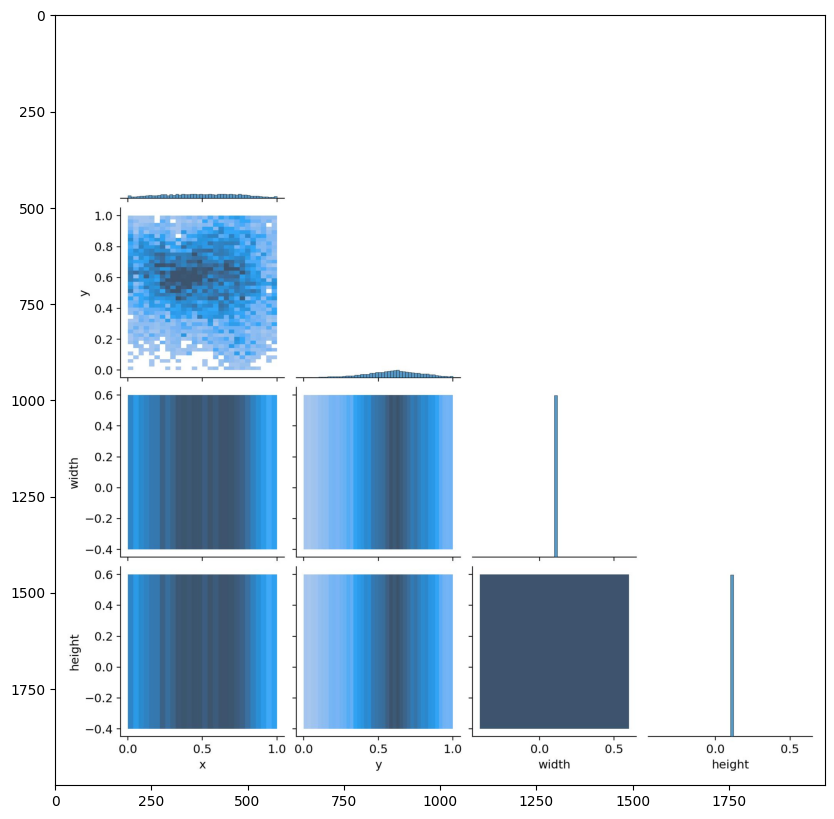

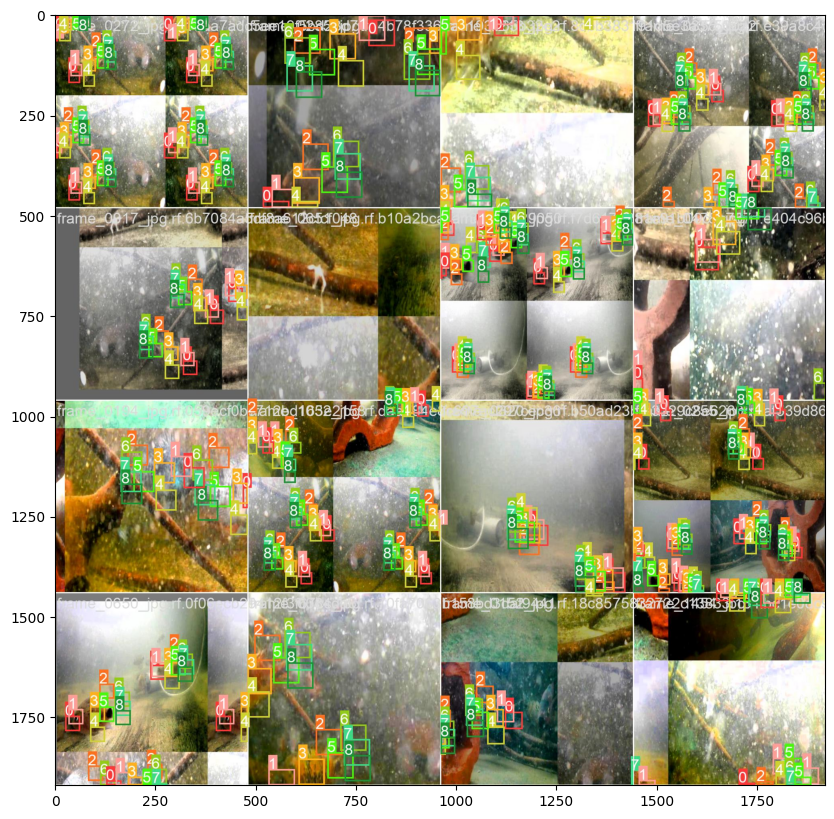

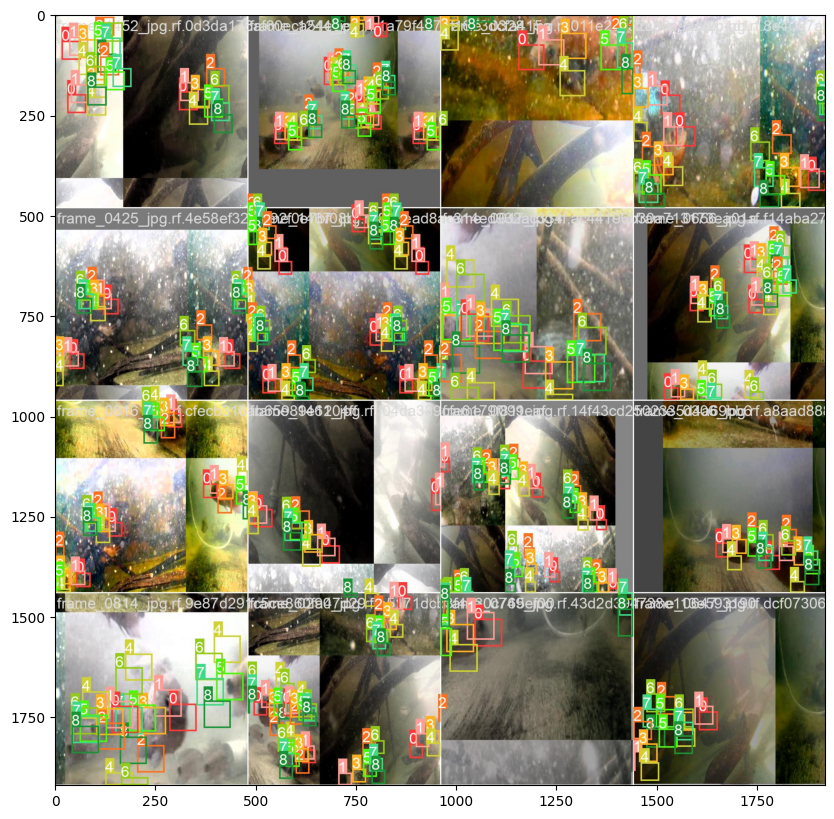

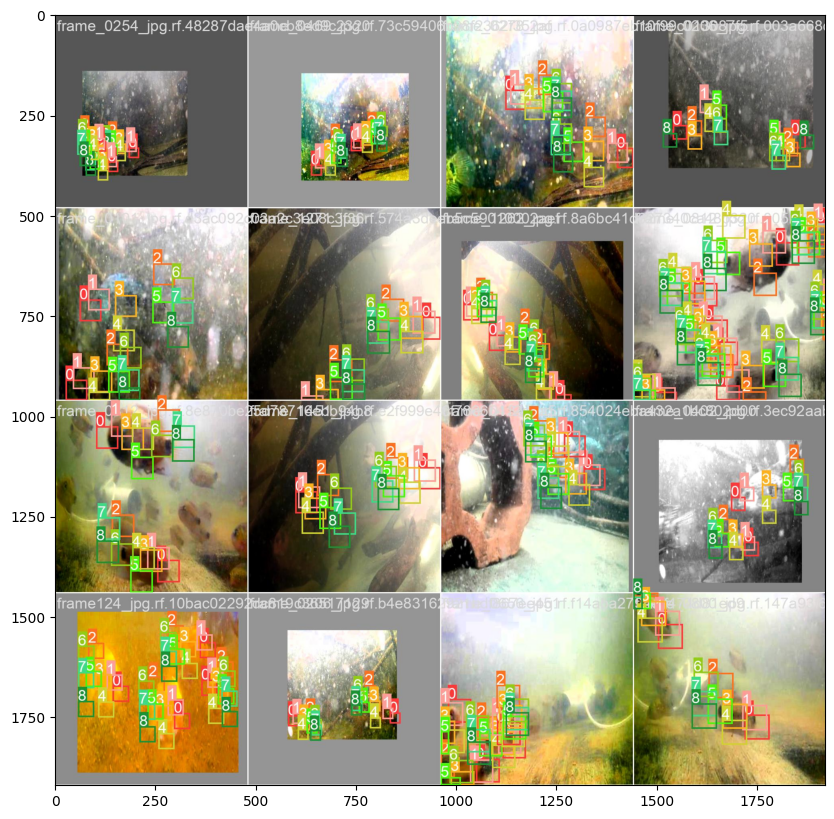

...

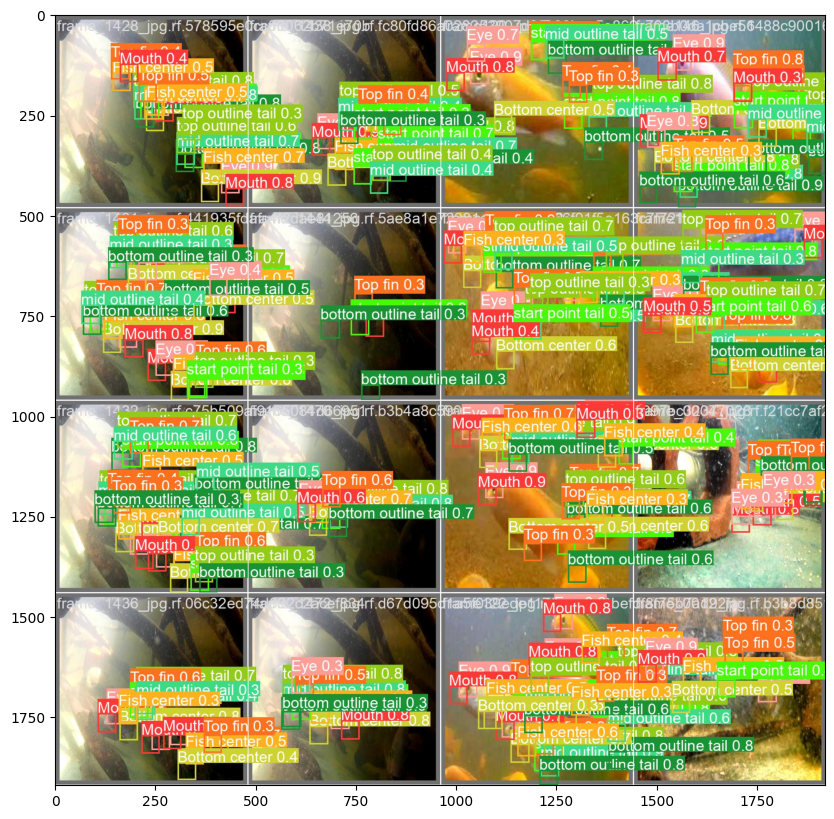

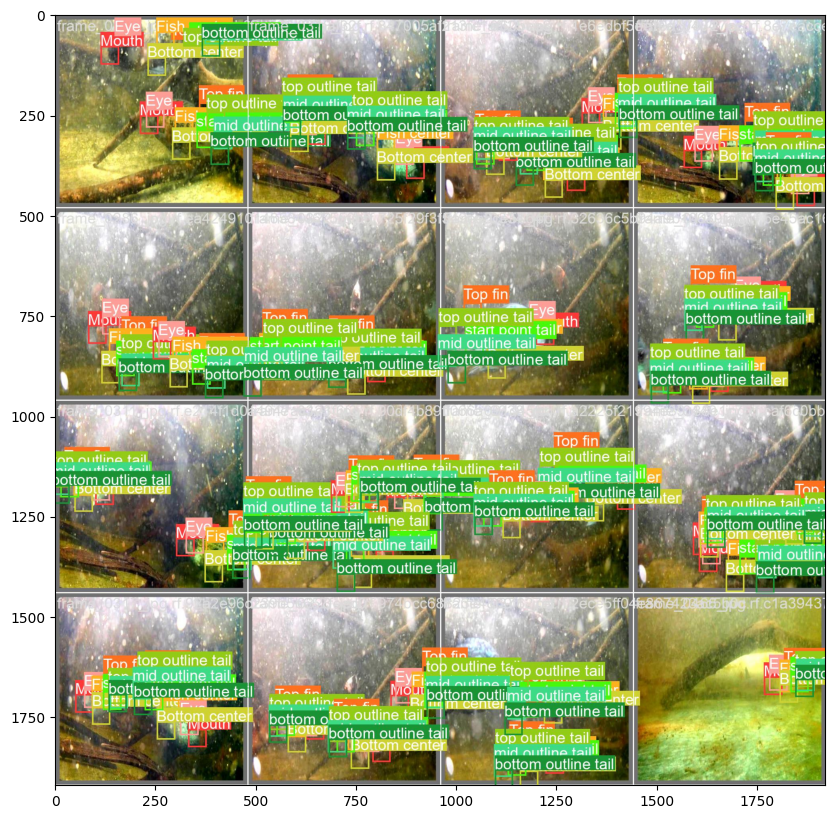

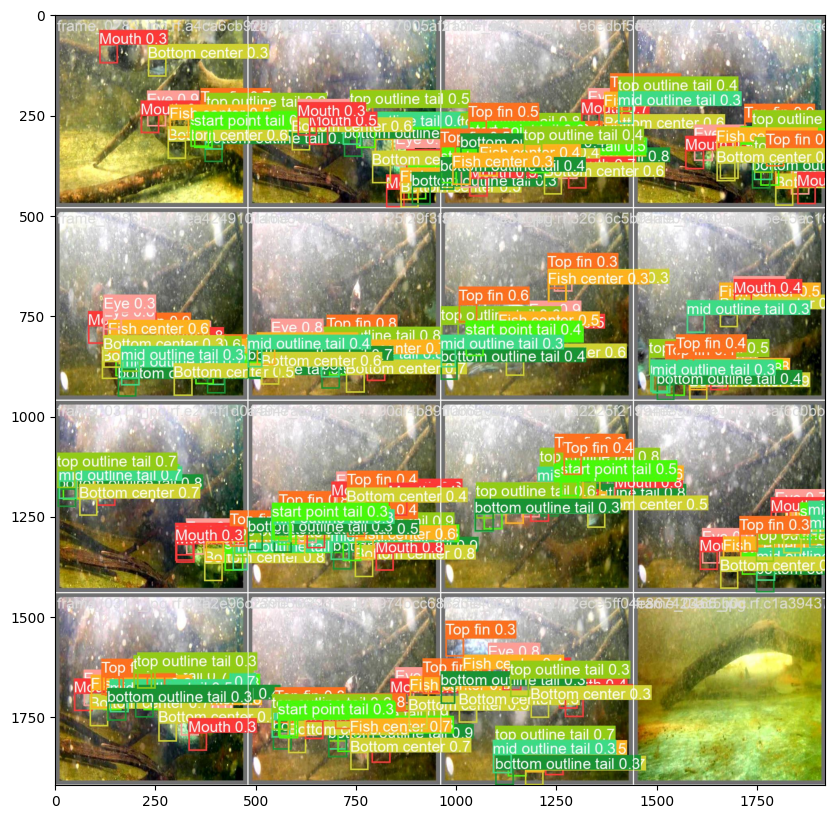

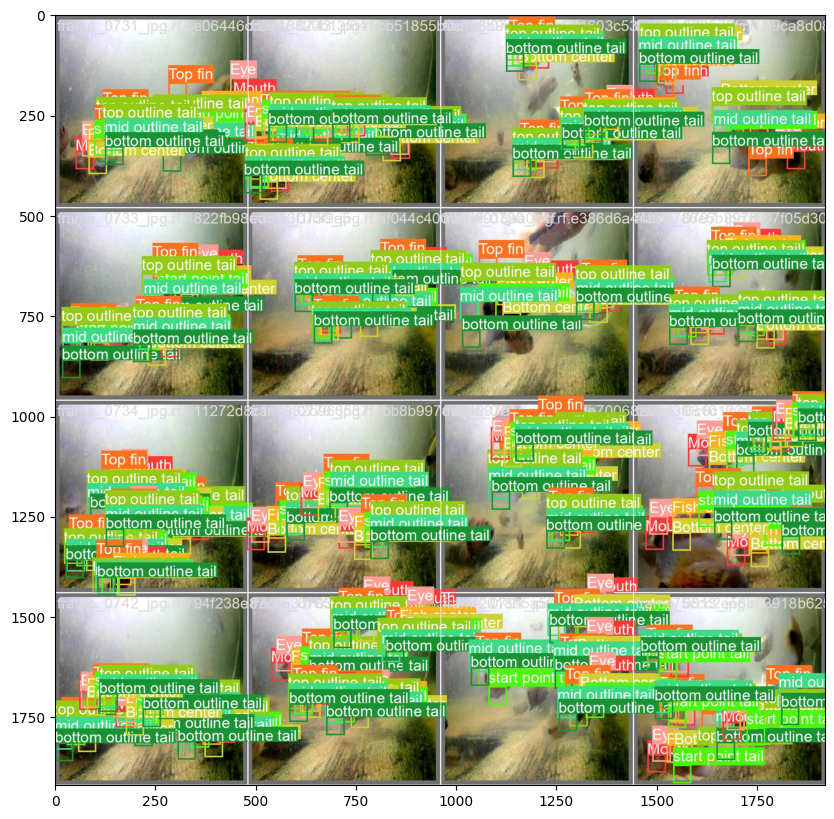

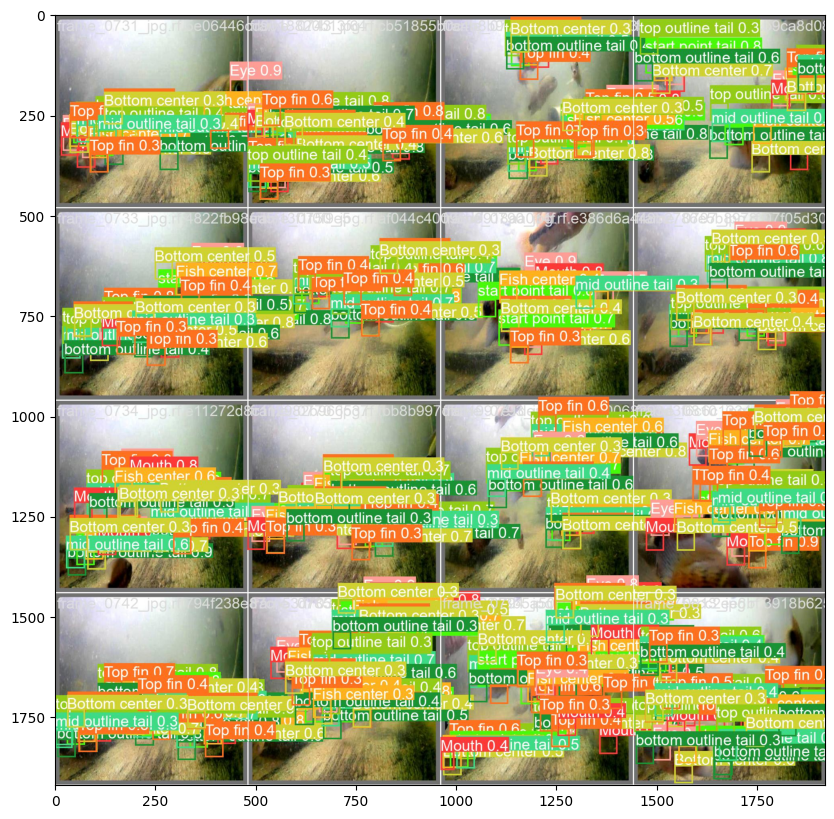

In [25]:
for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

**Output:**<br>

**Model Weights Path:** runs/detect/train2/weights/best.pt<br>
**Training Metrics:** The training process provided metrics such as loss, precision, recall, and mAP (mean Average Precision).

# Loading Trained Model
The trained model was used to make predictions on the test dataset.


In [26]:
best_path0='runs/detect/train2/weights/best.pt'
source0='/content/drive/MyDrive/Testing'

In [27]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(len(ppaths))

120


# Making Predictions

**Model Loading:** Loads the trained model and makes predictions on the test dataset.


In [28]:
model2 = YOLO(best_path0)

In [29]:
!yolo task=detect mode=predict model={best_path0} conf=0.7 source={source0}

Ultralytics YOLOv8.2.32 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68132235 parameters, 0 gradients, 257.4 GFLOPs

image 1/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c9843a8da708afbf0c62a3eede6.jpg: 640x640 1 Mouth, 2 Eyes, 1 top outline tail, 82.5ms
image 2/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-202611_png_jpg.rf.e57ebce5044a9f0661acc240af6a23a0.jpg: 640x640 1 Mouth, 1 Eye, 2 Top fins, 1 start point tail, 1 top outline tail, 2 bottom outline tails, 79.8ms
image 3/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-204332_png_jpg.rf.541df94b1a1bf0a54830577364efd30b.jpg: 640x640 2 Mouths, 2 Eyes, 2 Top fins, 2 start point tails, 1 top outline tail, 97.0ms
image 4/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-204358_png_jpg.rf.f46e972f571511894b73d7181fa49614.jpg: 640x640 1 Top fin, 1 start point tail, 2 bottom outline tails, 79.5ms
image 5/120 /content/drive/MyDr

**Making Predictions:** Used the model to predict on the test dataset.


In [30]:
results = model2.predict(source0,conf=0.7)
print(len(results))


image 1/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c9843a8da708afbf0c62a3eede6.jpg: 640x640 1 Mouth, 2 Eyes, 1 top outline tail, 96.7ms
image 2/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-202611_png_jpg.rf.e57ebce5044a9f0661acc240af6a23a0.jpg: 640x640 1 Mouth, 1 Eye, 2 Top fins, 1 start point tail, 1 top outline tail, 2 bottom outline tails, 68.2ms
image 3/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-204332_png_jpg.rf.541df94b1a1bf0a54830577364efd30b.jpg: 640x640 2 Mouths, 2 Eyes, 2 Top fins, 2 start point tails, 1 top outline tail, 68.2ms
image 4/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-204358_png_jpg.rf.f46e972f571511894b73d7181fa49614.jpg: 640x640 1 Top fin, 1 start point tail, 2 bottom outline tails, 64.4ms
image 5/120 /content/drive/MyDrive/Testing/Screenshot-2024-04-22-204446_png_jpg.rf.bc5b89da06cbcb35157955a753153205.jpg: 640x640 5 Mouths, 6 Eyes, 4 Top fins, 2 Fish centers, 3 Bottom centers, 6 start

In [31]:
print((results[0].boxes.data))

tensor([[138.0978,  97.9416, 203.5403, 164.2874,   0.8703,   1.0000],
        [110.5359, 476.1641, 177.5335, 541.6784,   0.8315,   1.0000],
        [297.3751, 341.3601, 362.1036, 406.7237,   0.7823,   6.0000],
        [ 68.1105, 168.5155, 133.7018, 234.5683,   0.7541,   0.0000]], device='cuda:0')


# Extracting and Displaying Results
Processed the prediction results to extract bounding boxes and class information.

In [32]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,138.097763,97.941612,203.540329,164.287445,0.870285,1.0,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
1,110.535919,476.164124,177.533478,541.678406,0.831472,1.0,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
2,297.375061,341.360077,362.103577,406.723724,0.782288,6.0,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
3,68.110519,168.515549,133.701782,234.568253,0.754059,0.0,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
0,279.703369,237.078674,343.718506,300.999329,0.824756,2.0,Screenshot-2024-04-22-202611_png_jpg.rf.e57ebc...,1.0
...,...,...,...,...,...,...,...,...
15,200.112427,53.071701,263.283142,116.264954,0.736422,2.0,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
16,263.188477,330.751892,328.238892,395.664185,0.731747,5.0,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
17,113.964020,531.000244,176.394562,592.825684,0.729293,8.0,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
18,10.690058,133.848022,72.992638,196.137543,0.716657,0.0,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0


In [33]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,138.097763,97.941612,203.540329,164.287445,0.870285,Eye,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
1,110.535919,476.164124,177.533478,541.678406,0.831472,Eye,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
2,297.375061,341.360077,362.103577,406.723724,0.782288,top outline tail,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
3,68.110519,168.515549,133.701782,234.568253,0.754059,Mouth,Screenshot-2024-04-22-201557_png_jpg.rf.8f2a4c...,0.0
4,279.703369,237.078674,343.718506,300.999329,0.824756,Top fin,Screenshot-2024-04-22-202611_png_jpg.rf.e57ebc...,1.0
...,...,...,...,...,...,...,...,...
1055,200.112427,53.071701,263.283142,116.264954,0.736422,Top fin,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
1056,263.188477,330.751892,328.238892,395.664185,0.731747,start point tail,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
1057,113.964020,531.000244,176.394562,592.825684,0.729293,bottom outline tail,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0
1058,10.690058,133.848022,72.992638,196.137543,0.716657,Mouth,frame973_jpg.rf.c4f5e7c7a3b0dd51284b2a0dfc71b4...,119.0


class
Eye                    294
start point tail       166
Mouth                  165
Top fin                138
top outline tail       101
bottom outline tail     99
mid outline tail        47
Bottom center           36
Fish center             14
Name: count, dtype: int64

6. Result of Predictions
The results included bounding boxes and class predictions for each test image. The predictions were visualized using bounding boxes on the images.


**Drawing Bounding Boxes:** Used OpenCV to draw bounding boxes on the images.

In [36]:
# Define the colors for each label
colors = {
    'head': (0, 0, 255),  # Red
    'tail': (0, 255, 0),  # Lime
    'Mouth': (255, 0, 0),  # Blue
    'Eye': (0, 255, 255),  # Yellow
    'Top fin': (255, 0, 255),  # Magenta
    'Fish center': (255, 255, 0),  # Cyan
    'Bottom center': (128, 0, 128),  # Purple
    'start point tail': (128, 128, 0),  # Olive
    'top outline tail': (0, 128, 128),  # Teal
    'mid outline tail': (128, 128, 128),  # Gray
    'bottom outline tail': (0, 0, 128)  # Navy
}

def draw_box2(n0):
    ipath = ppaths[n0]
    image = cv2.imread(ipath)
    H, W = image.shape[0], image.shape[1]
    file = ipath.split('/')[-1]

    if PBOX[PBOX['file'] == file] is not None:
        box = PBOX[PBOX['file'] == file]
        box = box.reset_index(drop=True)

        for i in range(len(box)):
            label = box.loc[i, 'class']
            x = int(box.loc[i, 'x'])
            y = int(box.loc[i, 'y'])
            x2 = int(box.loc[i, 'x2'])
            y2 = int(box.loc[i, 'y2'])

            # Get the color for the label
            color = colors.get(label, (255, 255, 255))  # Default to white if label not found

            cv2.rectangle(image, (x, y), (x2, y2), color, 2)

    return image

**Creating Animation:** Created an animation of the images with bounding boxes.


# Result of Predictions

In [37]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [38]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 120/120 [00:01<00:00, 84.89it/s]


In [40]:
create_animation(images2)

In [45]:
!zip -r 'runs.zip' '/content/runs'

  adding: content/runs/ (stored 0%)
  adding: content/runs/detect/ (stored 0%)
  adding: content/runs/detect/train/ (stored 0%)
  adding: content/runs/detect/train/train_batch0.jpg (deflated 0%)
  adding: content/runs/detect/train/events.out.tfevents.1718422886.8074e175325d.3896.0 (deflated 93%)
  adding: content/runs/detect/train/args.yaml (deflated 53%)
  adding: content/runs/detect/train/train_batch1.jpg (deflated 2%)
  adding: content/runs/detect/train/labels_correlogram.jpg (deflated 57%)
  adding: content/runs/detect/train/labels.jpg (deflated 33%)
  adding: content/runs/detect/train/results.csv (deflated 83%)
  adding: content/runs/detect/train/weights/ (stored 0%)
  adding: content/runs/detect/train/weights/last.pt (deflated 46%)
  adding: content/runs/detect/train/weights/best.pt (deflated 46%)
  adding: content/runs/detect/train/train_batch2.jpg (deflated 1%)
  adding: content/runs/detect/train2/ (stored 0%)
  adding: content/runs/detect/train2/val_batch1_labels.jpg (deflated